In [1]:
%matplotlib inline

In [ ]:
#Шпитальник Александр Сергеевич

In [2]:
import torchvision.models as models
import torchvision.transforms as transforms
import torch
from torch.autograd import Variable
import numpy as np
from PIL import Image
import copy

from IPython.display import display

In [3]:
mean=[0.485, 0.456, 0.406] 
std=[0.229, 0.224, 0.225]
trans = transforms.Compose([
            transforms.Normalize(mean, std)
        ])
    
def numpy2image(img_numpy):
    if img_numpy.dtype == np.dtype('float64'): #нужно домножить на 255 и поменять тип
        img_numpy = (img_numpy*255).astype('uint8')
    return Image.fromarray(img_numpy)

# [DeepDream](https://research.googleblog.com/2015/06/inceptionism-going-deeper-into-neural.html)
Используем тот же самый метод Gradient Ascent. Только в этом случае усиливаем действие не одного нейрона а всей группы на слое
1. Пропускаем картинку через сеть
2. Устанавливаем градиент выбранного слоя (не нейрона) равным их активации (dx=x)
3. Делаем backward
4. Обновляем картинку <br/>
В нашем случае функция, которую мы максимизируем
$$ I^* = arg max ( \sum_i f_i (I)^2) $$

Дополнительно, делают:
1. смешения картинки (то есть при каждой итерации циклически поворачивают картинку) np.roll + 
2. нормализацию градиента (на среднее или l1 норму)
3. клип значений пикселей np.clip - чтобы срезать значения ниже 0 и выше 1

![DeepDream](./img/DeepDream.png)

---
Можно модифицировать код выше:
* взять нужный слой, заменив AlexNet на FeaturesExtractor
* сделав небольшие смещения входной картинки. 
* на вход подовать не шум, а изображение

In [51]:
img_deep_dream =  np.asarray(Image.open('img.jpg')) / 255.0

In [52]:
img_deep_dream.dtype == np.dtype('float64')

True

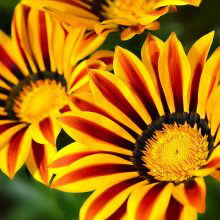

In [53]:
numpy2image(img_deep_dream)

In [11]:
 #Пример как сделать forward до заданного слоя в resnet
net = models.resnet34(pretrained=True)

def my_forward(self, x):
    x = self.conv1(x)
    x = self.bn1(x)
    x = self.relu(x)
    x = self.maxpool(x)
    x = self.layer1(x)

    return x

in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True)
my_forward(net, in_img)

tensor([[[[1.1801, 0.3549, 0.2004,  ..., 0.8782, 1.3443, 0.2401],
          [1.4066, 0.3298, 0.0000,  ..., 0.5606, 0.6260, 0.4231],
          [1.2756, 0.6174, 0.0000,  ..., 0.0004, 0.2666, 0.9262],
          ...,
          [0.6110, 0.3244, 1.4084,  ..., 0.3241, 0.3135, 0.2343],
          [1.0502, 1.2751, 1.8541,  ..., 0.0000, 0.0000, 0.8649],
          [1.5157, 0.1976, 0.0690,  ..., 0.0000, 0.2823, 1.5974]],

         [[0.5434, 0.8561, 0.5541,  ..., 0.8401, 0.4925, 1.2878],
          [0.5264, 0.8164, 0.4981,  ..., 0.9348, 0.3532, 1.1023],
          [0.4514, 0.6082, 0.5340,  ..., 0.2466, 0.2215, 1.0524],
          ...,
          [0.3501, 0.6260, 0.6270,  ..., 0.7883, 1.4100, 1.2344],
          [0.5200, 0.5835, 0.4648,  ..., 0.6461, 1.1282, 1.3090],
          [0.2092, 0.0190, 0.0189,  ..., 0.1033, 0.1589, 0.9548]],

         [[1.7627, 1.4564, 0.7999,  ..., 1.8359, 1.5299, 2.1800],
          [0.7593, 0.9338, 0.8588,  ..., 1.2964, 1.2392, 1.0527],
          [0.6393, 0.9797, 0.7799,  ..., 1

In [9]:
print(net)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Co

## Задание 1
#### Применить всю сеть без fullconnected слоев (должны получить лица животных и что-то визуально внятное)

Iter 0


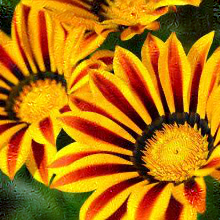

()
Iter 5


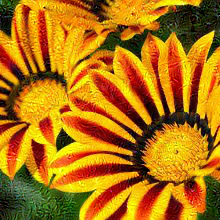

()
Iter 10


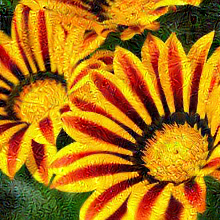

()
Iter 15


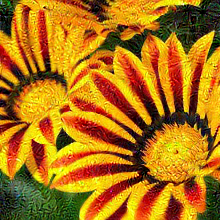

()
Iter 20


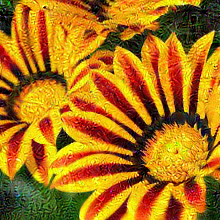

()
Iter 25


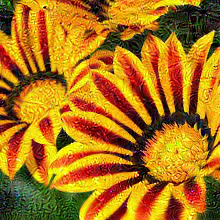

()
Iter 30


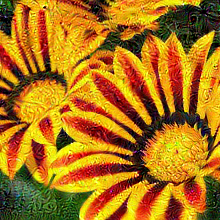

()
Iter 35


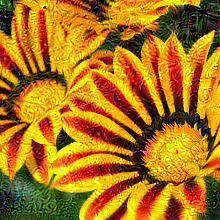

()
Iter 40


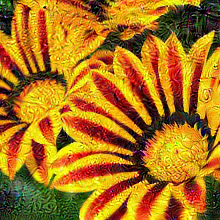

()
Iter 45


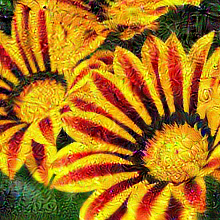

()
Iter 50


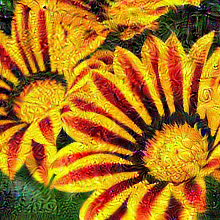

()
Iter 55


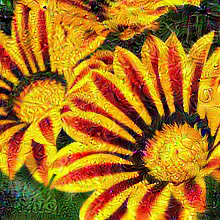

()
Iter 60


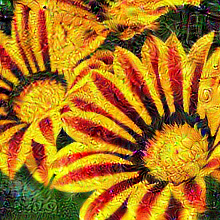

()
Iter 65


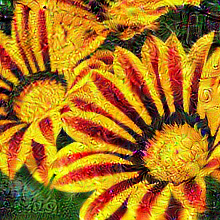

()
Iter 70


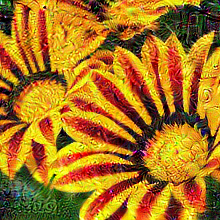

()
Iter 75


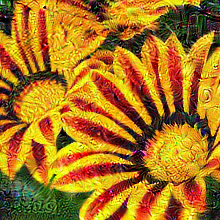

()
Iter 80


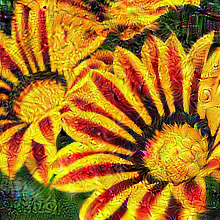

()
Iter 85


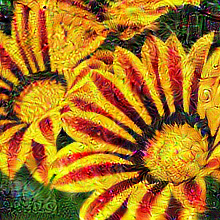

()
Iter 90


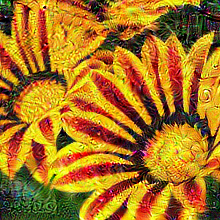

()
Iter 95


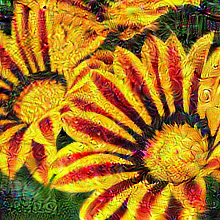

()
Iter 100


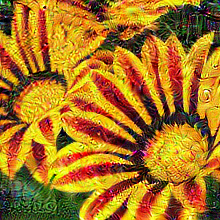

()
Iter 105


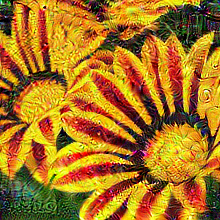

()
Iter 110


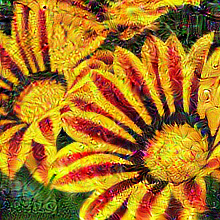

()
Iter 115


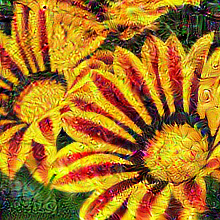

()
Iter 120


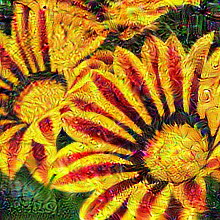

()
Iter 125


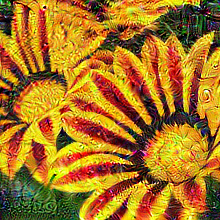

()
Iter 130


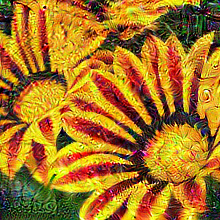

()
Iter 135


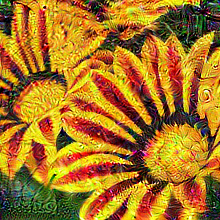

()
Iter 140


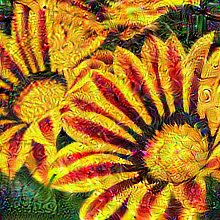

()
Iter 145


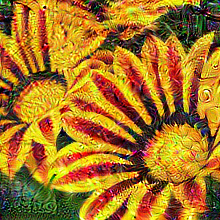

()
Iter 150


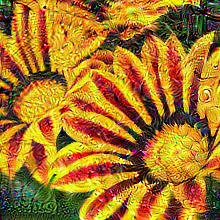

()
Iter 155


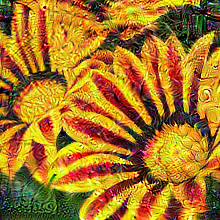

()
Iter 160


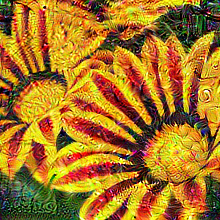

()
Iter 165


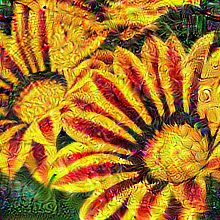

()
Iter 170


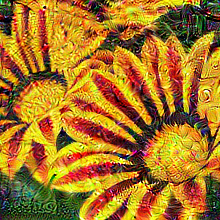

()
Iter 175


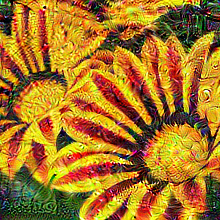

()
Iter 180


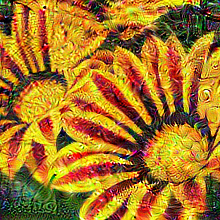

()
Iter 185


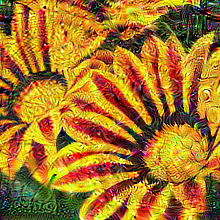

()
Iter 190


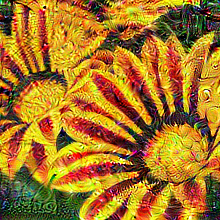

()
Iter 195


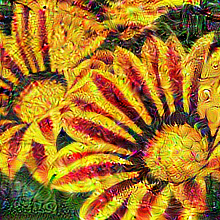

()
Iter 199


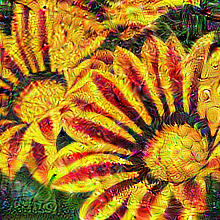

()


In [87]:
img = copy.deepcopy(img_deep_dream)

max_jitter = 32
step_size = 0.01
TRACE_ITER = 5
for iter_id in range(200):

    shift_x, shift_y = np.random.randint( -max_jitter, max_jitter + 1, 2)
    img = np.roll(np.roll(img, shift_x, -1), shift_y, -2)

    in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
    in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True) # тут нам нужен будет градиент
    
    x = in_img

    x = net.conv1(x)
    x = net.bn1(x)
    x = net.relu(x)
    x = net.maxpool(x)

    x = net.layer1(x)
    x = net.layer2(x)
    x = net.layer3(x)
    x = net.layer4(x)
    
    #forward до нужного слоя
    #backward dx=x
    
    
    x.backward(x)

    grad = in_img.grad.data
    grad = grad[0, :, :, :]
    grad =  grad.transpose(0,1).transpose(1,2).numpy() #превращаем градиент в numpy 

    #обновление картинки img
    img = img + step_size * grad
    

    img = np.roll(np.roll(img, -shift_x, -1), -shift_y, -2)
    img = np.clip(img, 0, 1)
    if iter_id % TRACE_ITER == 0:
        print("Iter %d" % iter_id)
        display(numpy2image(img))
        print()
        
print("Iter %d" % iter_id)
display(numpy2image(img))
print()

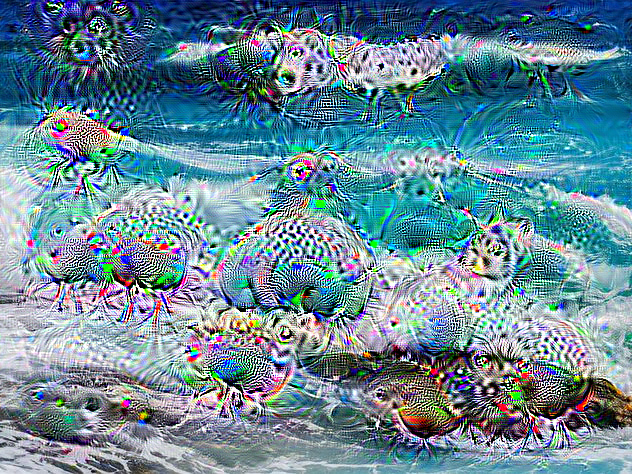

In [8]:
numpy2image(img)

## Задание 2

#### Сделать deep dream по нижним слоям (после 1-2 конволюций) - должы закрасить некоторой текстурой картинку в итоге

Iter 0


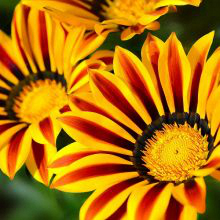

()
Iter 5


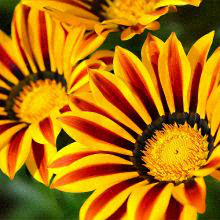

()
Iter 10


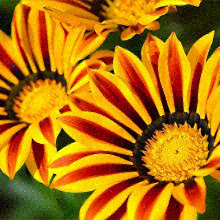

()
Iter 15


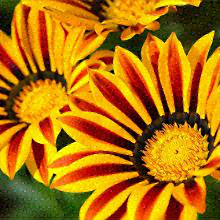

()
Iter 20


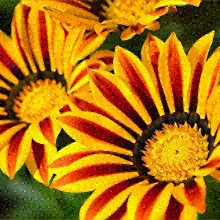

()
Iter 25


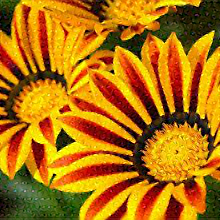

()
Iter 30


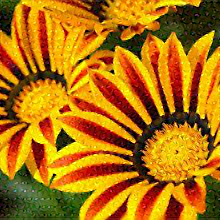

()
Iter 35


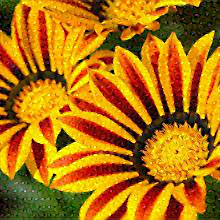

()
Iter 40


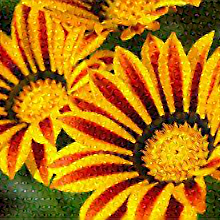

()
Iter 45


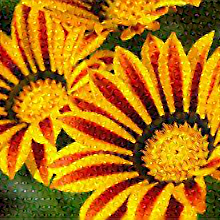

()
Iter 50


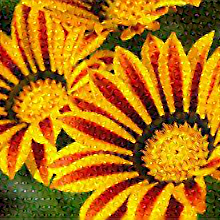

()
Iter 55


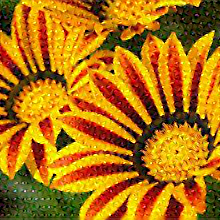

()
Iter 60


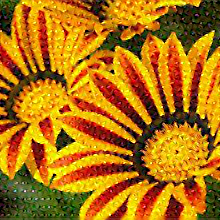

()
Iter 65


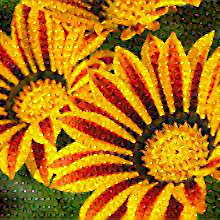

()
Iter 70


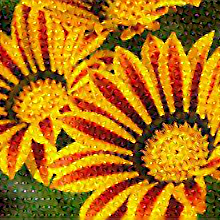

()
Iter 75


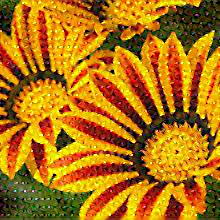

()
Iter 80


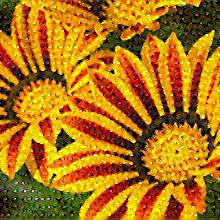

()
Iter 85


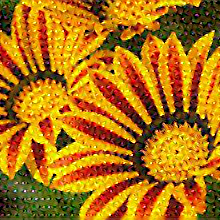

()
Iter 90


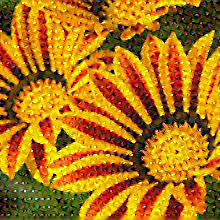

()
Iter 95


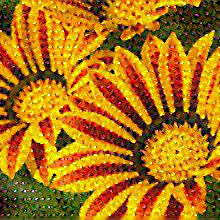

()
Iter 99


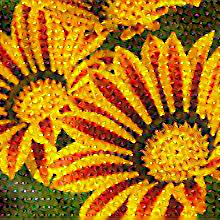

()


In [93]:
img = copy.deepcopy(img_deep_dream)

max_jitter = 32
step_size = 0.01
TRACE_ITER = 5
for iter_id in range(100):

    shift_x, shift_y = np.random.randint( -max_jitter, max_jitter + 1, 2)
    img = np.roll(np.roll(img, shift_x, -1), shift_y, -2)

    in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
    in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True) # тут нам нужен будет градиент
    
    x = in_img

    x = net.conv1(x)
    x = net.bn1(x)
    x = net.relu(x)
    x = net.maxpool(x)
   

    #forward до нужного слоя
    #backward dx=x
    
    
    #in_img.grad = in_img.data
    x.backward(x)


    grad = in_img.grad.data
    grad = grad[0, :, :, :]
    grad =  grad.transpose(0,1).transpose(1,2).numpy() #превращаем градиент в numpy 

    #обновление картинки img
    img = img + step_size * grad
    

    img = np.roll(np.roll(img, -shift_x, -1), -shift_y, -2)
    img = np.clip(img, 0, 1)
    if iter_id % TRACE_ITER == 0:
        print("Iter %d" % iter_id)
        display(numpy2image(img))
        print()
        
print("Iter %d" % iter_id)
display(numpy2image(img))
print()

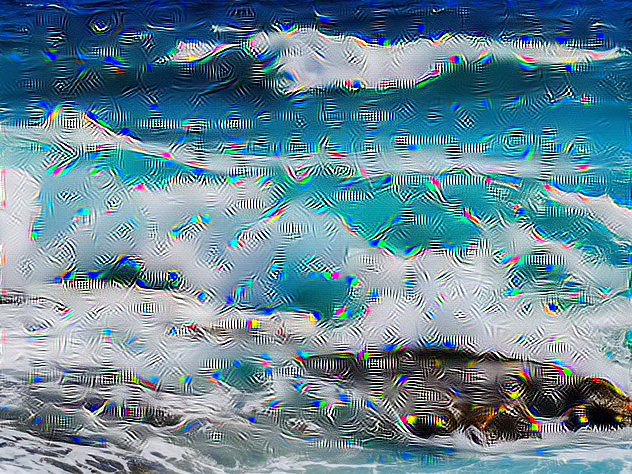

In [10]:
numpy2image(img)

## Задание 3
#### Сделать deep dream по средним слоям - должы закрасить некоторыми осмысленными узорами картинку в итоге

Iter 0


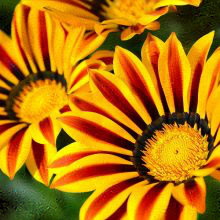

()
Iter 5


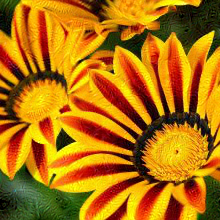

()
Iter 10


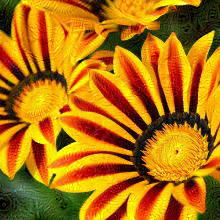

()
Iter 15


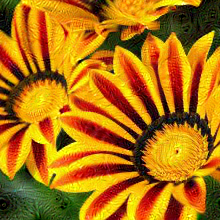

()
Iter 20


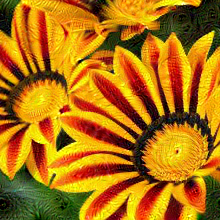

()
Iter 25


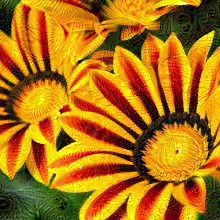

()
Iter 30


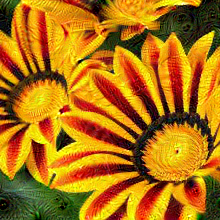

()
Iter 35


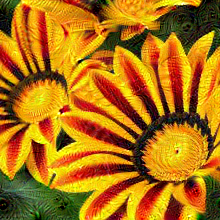

()
Iter 40


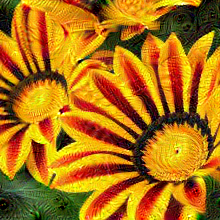

()
Iter 45


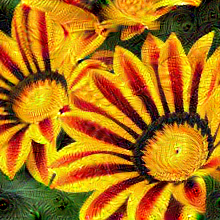

()
Iter 50


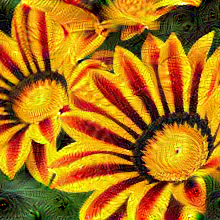

()
Iter 55


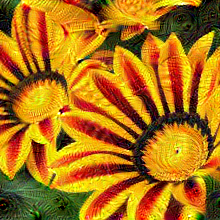

()
Iter 60


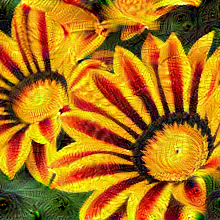

()
Iter 65


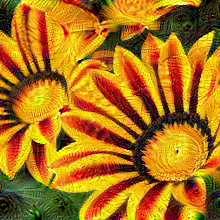

()
Iter 70


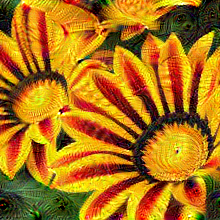

()
Iter 75


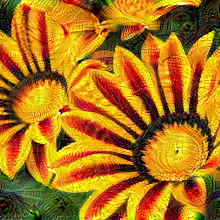

()
Iter 80


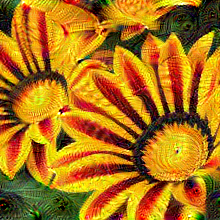

()
Iter 85


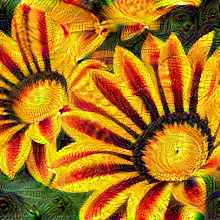

()
Iter 90


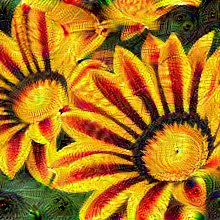

()
Iter 95


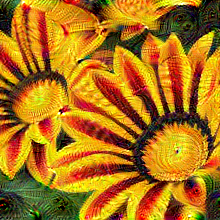

()
Iter 100


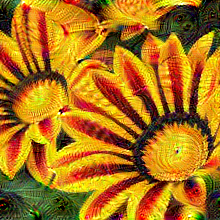

()
Iter 105


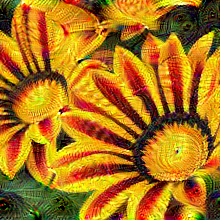

()
Iter 110


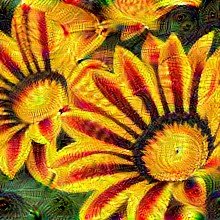

()
Iter 115


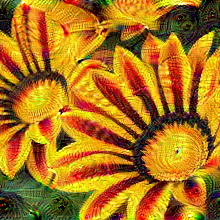

()
Iter 120


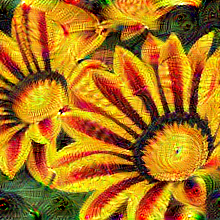

()
Iter 125


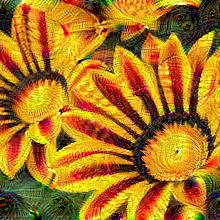

()
Iter 130


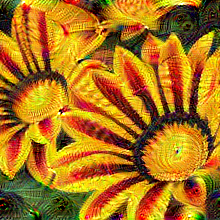

()
Iter 135


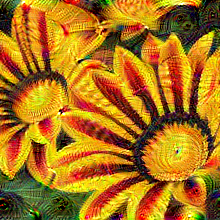

()
Iter 140


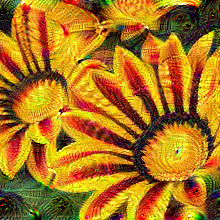

()
Iter 145


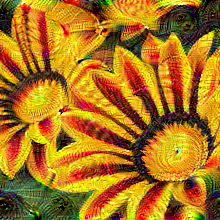

()
Iter 150


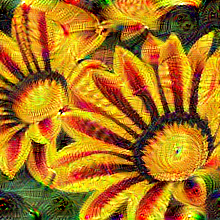

()
Iter 155


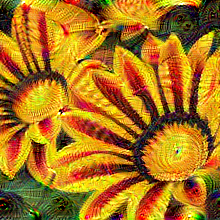

()
Iter 160


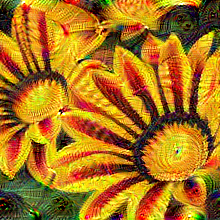

()
Iter 165


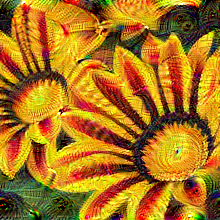

()
Iter 170


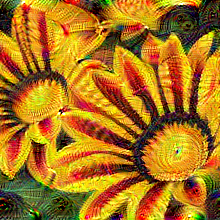

()
Iter 175


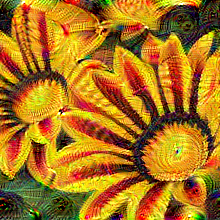

()
Iter 180


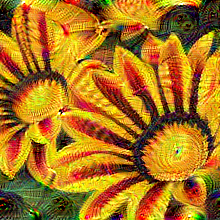

()
Iter 185


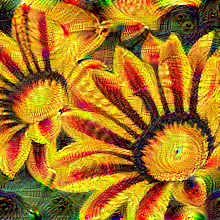

()
Iter 190


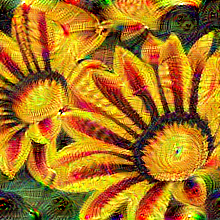

()
Iter 195


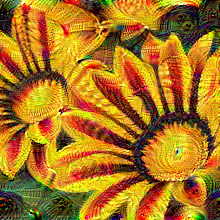

()
Iter 199


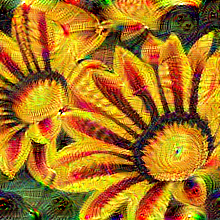

()


In [94]:
img = copy.deepcopy(img_deep_dream)

max_jitter = 32
step_size = 0.05
TRACE_ITER = 5
for iter_id in range(200):

    shift_x, shift_y = np.random.randint( -max_jitter, max_jitter + 1, 2)
    img = np.roll(np.roll(img, shift_x, -1), shift_y, -2)

    in_img = torch.from_numpy(img).transpose(2,1).transpose(1,0).float()
    in_img = Variable(trans(in_img).unsqueeze(0), requires_grad=True) # тут нам нужен будет градиент
    
    x = in_img

    x = net.conv1(x)
    x = net.bn1(x)
    x = net.relu(x)
    x = net.maxpool(x)

    x = net.layer1(x)
    x = net.layer2(x)
   

    #forward до нужного слоя
    #backward dx=x
    
    x.backward(x)

    grad = in_img.grad.data
    grad = grad[0, :, :, :]
    grad =  grad.transpose(0,1).transpose(1,2).numpy() #превращаем градиент в numpy 

    #обновление картинки img
    img = img + step_size * grad
    

    img = np.roll(np.roll(img, -shift_x, -1), -shift_y, -2)
    img = np.clip(img, 0, 1)
    if iter_id % TRACE_ITER == 0:
        print("Iter %d" % iter_id)
        display(numpy2image(img))
        print()
        
print("Iter %d" % iter_id)
display(numpy2image(img))
print()

Sequential(
  (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
  (1): ReLU(inplace)
  (2): MaxPool2d(kernel_size=(3, 3), stride=(2, 2), dilation=(1, 1), ceil_mode=False)
  (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (4): ReLU(inplace)
  (5): MaxPool2d(kernel_size=(3, 3), stride=(2, 2), dilation=(1, 1), ceil_mode=False)
  (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (7): ReLU(inplace)
  (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (9): ReLU(inplace)
  (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace)
  (12): MaxPool2d(kernel_size=(3, 3), stride=(2, 2), dilation=(1, 1), ceil_mode=False)
)


/home/a.murashev/anaconda3/envs/pytorch/lib/python3.6/site-packages/torch/autograd/__init__.py:93: UserWarning: retain_variables option is deprecated and will be removed in 0.3. Use retain_graph instead.
  warnings.warn("retain_variables option is deprecated and will be removed in 0.3. "


Iter 0


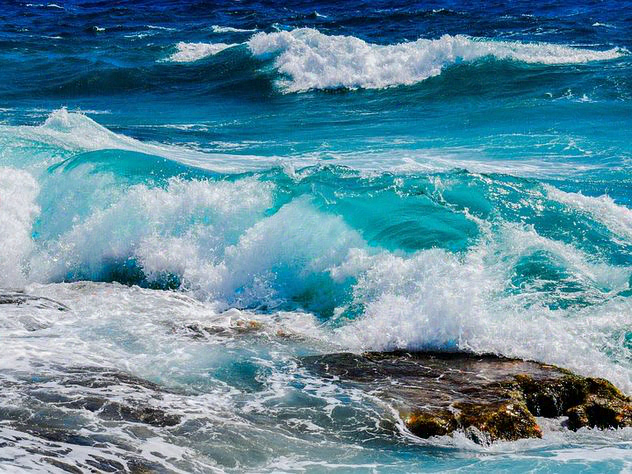


Iter 7


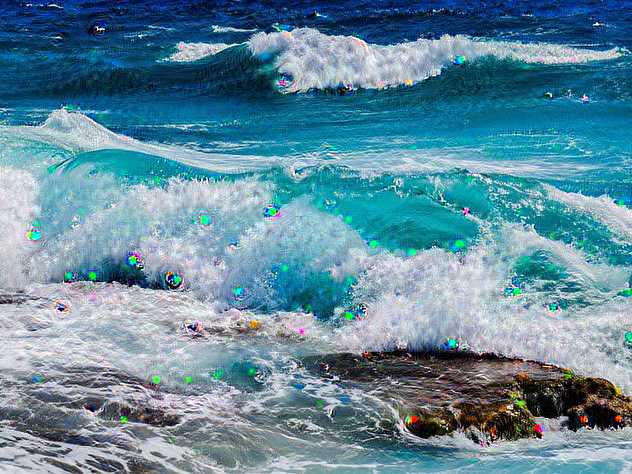


Iter 14


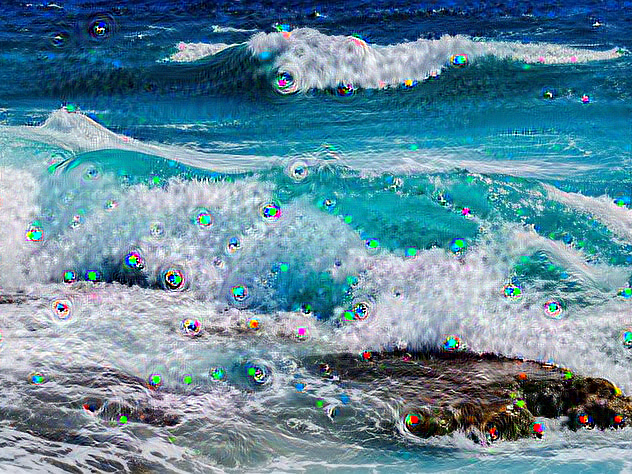


Iter 21


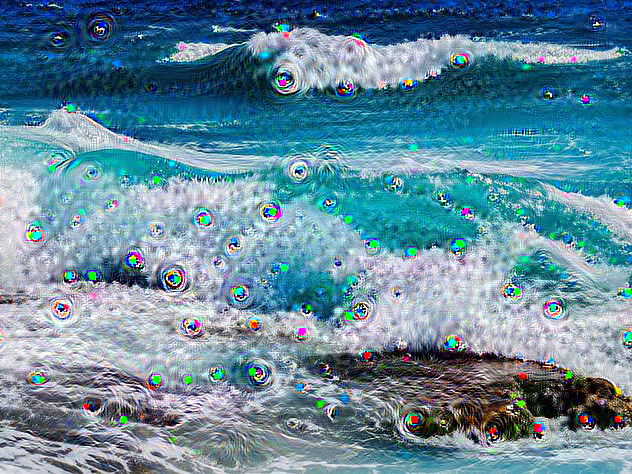


Iter 28


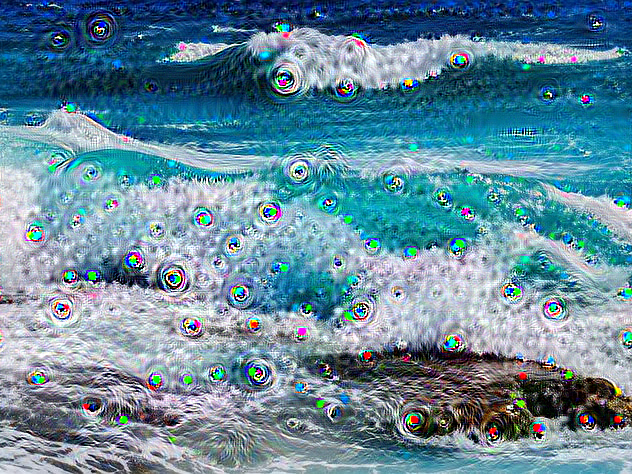


Iter 35


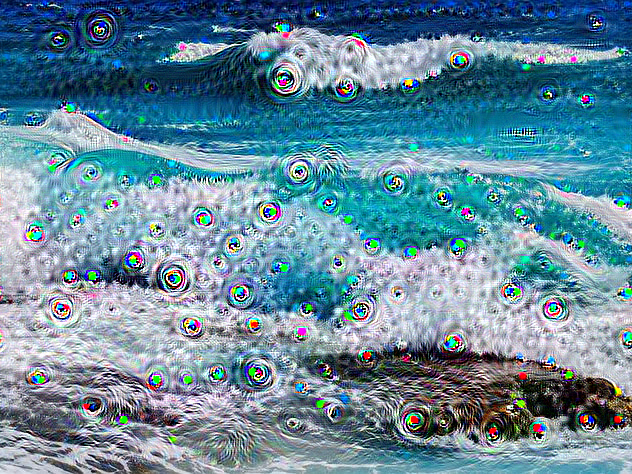


Iter 42


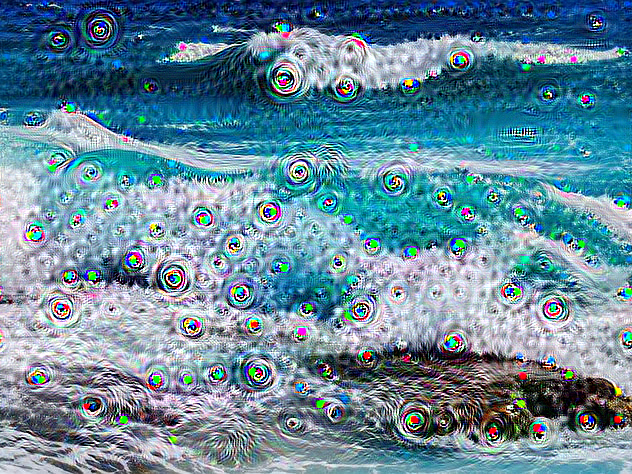


Iter 49


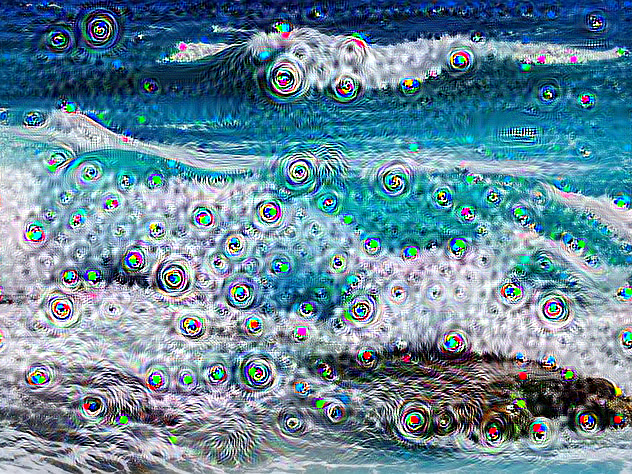


Iter 56


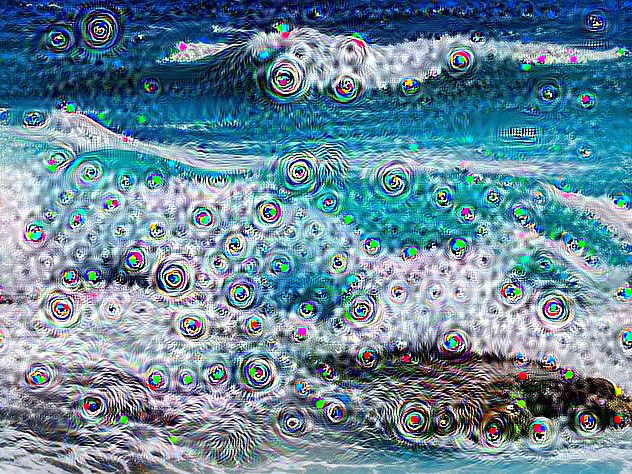


Iter 63


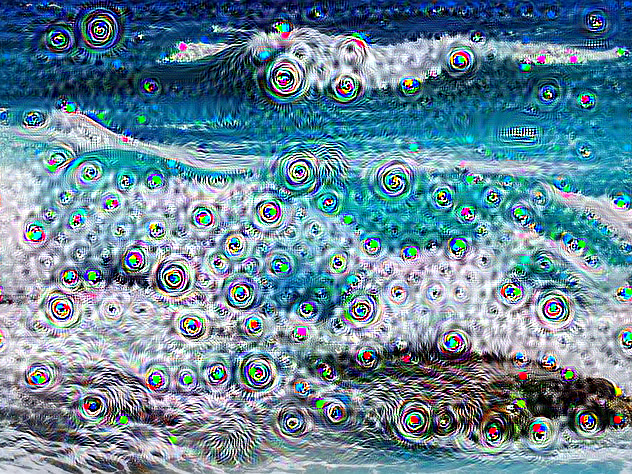


Iter 69


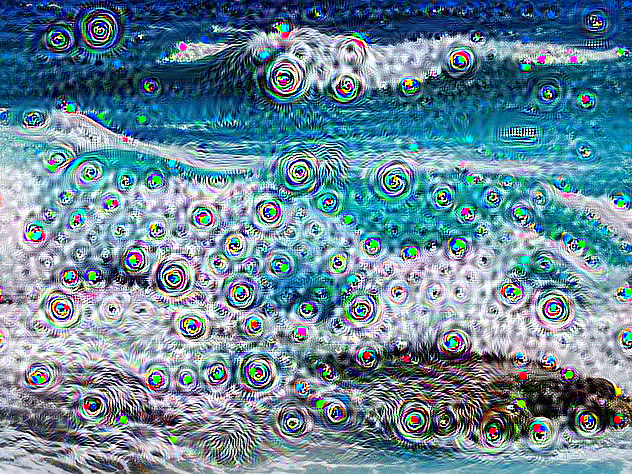

In [11]:
pass